# LIBRARIES

* Execute this cell to import the libraries we need.

In [1]:
import ipywidgets as widgets
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy
import os, sys, inspect
from helper import interactive_superposition_plot, standing_animation, ring_wave_animation

<br/><br/>
<!--  -->

# OPTICS

## PART 1 - Wave Superposition
An important principle of wave behavior is __superposition__ - When two waves combine, the resultant wave is simply their sum. Waves are not "more than the sum of their parts"—they _are_ the sum of their parts.

Because of this, any waveform can be decomposed into a sum of pure sine and cosine waves of specific frequencies. This can be done using the __Fourier Transform__, which transforms a signal from the time domain to the frequency domain.

> This descriptioin of the Fourier Transform is sufficient for our purposes.
> If you are curious about the details, check out this excellent video:
> [3Blue1Brown's Fourier Transform Explanation (YouTube)](https://www.youtube.com/watch?v=spUNpyF58BY&t=554s)

### CODE EXPLANATION
ne of the central ideas in programming is **abstraction**: isolating a task into a clearly defined, reusable unit.  
In Python, the most basic form of abstraction is the **function**.

A function is a named block of code that maps inputs to outputs, much like a mathematical function.  
This provides:
- **Modularity**: code can be developed and tested in parts.  
- **Reusability**: a procedure can be called repeatedly without duplication.  
- **Clarity**: details are encapsulated so that the focus is on *what* the function does rather than *how*.
The `superposition_plot` function below displays how we can take input data, apply a fourier transform, and then plot the results. 

`matplotlib` is Python’s core library for producing figures. It is built around an **object-oriented interface**: each figure you create is an object with its own internal data and methods (functions attached to the object) for drawing and formatting. 
For example:

```python
fig, (ax1, ax2) = plt.subplots(2, 1)
```
- `fig` is a [Figure](https://matplotlib.org/stable/api/_as_gen/matplotlib.figure.Figure.html#matplotlib.figure.Figure) object: the overall container for everything in the plot.
- `ax1` and `ax2` are [Axes](https://matplotlib.org/stable/api/_as_gen/matplotlib.axes.Axes.html#matplotlib.axes.Axes) objects: individual coordinate systems inside the figure.
Each of these objects has its own methods, for example:
```python
ax1.scatter([0, 1, 2, 3][ 1, 3, 5, 7])
```
will draw a simple scatter plot of points on a straight line. For more details on the function below, consult the [matplotlib quick start guide](https://matplotlib.org/stable/users/explain/quick_start.html). We can think of the `Figure` as the canvas, which sets the overall background, size, and layout, while each `Axes` object defines a region of that canvas, with its methods acting as the tools that “paint” the data onto the plot. This abstraction mirrors painting in the real world, but through objects and methods, it allows us to control and organize the process of drawing on a computer in a structured, intuitive way.

**DO NOT** modify these cells, just run them and answer the following questions.

In [2]:
def superposition_plot(f1, p1, f2, p2):
    fig, (ax1, ax2) = plt.subplots(2,1)
    x, y_1, y_2, y_superposition = waves_and_superposition(f1,p1,f2,p2)

    ax1.plot(x,y_1,label='First Wave',alpha=0.6,color='red')
    ax1.plot(x,y_2,label='Second Wave',alpha=0.6,color='orange')
    ax1.plot(x, y_superposition,label='Sum of waves',color='blue')
    ax1.set_title('Wave Superposition')
    ax1.set_xlabel('Time (s)')
    ax1.set_ylabel('Amplitude')
    ax1.set_ylim(-3, 3)
    ax1.set_xlim(0,4)

    fourier_x, fourier_y = fourier_transform(y_superposition)
    ax2.plot(fourier_x,fourier_y)
    ax2.set_title('Fourier Transform of Resulting Wave')
    ax2.set_xlabel('Frequency (Hz)')
    ax2.set_ylabel('Contribution')
    ax2.set_xlim(0,6)
    ax2.set_ylim(0,1.05)

    plt.subplots_adjust(hspace=0.6)
    plt.show()

`NumPy` is a Python library for numerical computing that provides powerful tools for working with arrays and matrices. It offers fast, vectorized operations, mathematical functions, and linear algebra routines, making it the foundation for most scientific and data analysis workflows in Python. The custom function below will process our signals for us using the `NumPy` fast Fourier transform. Here is the [documentation](https://numpy.org/doc/stable/reference/routines.fft.html) for this fft object.

In [3]:
def fourier_transform(signal):
    sampling_rate = 64  
    T = 1 / sampling_rate  
    
    n = len(signal)
    fft_signal = np.fft.fft(signal)
    fft_signal = fft_signal / n 
    
    frequencies = np.fft.fftfreq(n, T)
    
    positive_frequencies = frequencies[:n // 2]
    fft_signal_magnitude = np.abs(fft_signal[:n // 2])
    return positive_frequencies, fft_signal_magnitude

### Question
Explain what data type the parameters of these calls are (here is a list of built in [python types](https://docs.python.org/3/library/stdtypes.html) and [numpy types](https://numpy.org/doc/stable/user/basics.types.html)), what each parameter controls, and what does the output give us. For example take the function `round(number=3.14159, ndigits=2)`. Here, the parameter `number` is a `float` that specifies the value we want to round, while `ndigits` is an `int` that controls how many decimal places to keep, and the output is a `float` equal to 3.14.
1. `len(signal)`
2. `np.fft.fft(signal)`
3. `np.fft.fftfreq(n, T)`

### Instructions
The core wave and plotting logic is already implemented in the helper file. You only need to call the interactive function `interactive_superposition_plot()` provided. Use the sliders to explore how changing frequency and phase affects the resulting wave and its Fourier spectrum.

In [4]:
interactive_superposition_plot()

interactive(children=(FloatSlider(value=2.0, description='f1', max=5.0), FloatSlider(value=10.0, description='…

<function helper.superposition_plot(f1, p1, f2, p2)>

### SHORT RESPONSE QUESTIONS
1. How do the frequencies of the component waves relate to the frequencies observed in the Fourier transform of their superposition?
2. Does changing the phase of each wave affect this relationship?
3. How is superposition related to constructive and destructive interference?
### ANSWER

<br/><br/>

<br/><br/>

<br/><br/>
<br/><br/>

<br/><br/>
<br/><br/>

# WAVES

## PART 1 - QUANTIZATION
In free space, Maxwell’s equations imply that the electric field component $E(x,t)$ satisfies the one-dimensional wave equation
$$ \frac{\partial^2 E(x, t)}{\partial x^2} = \frac{1}{c^2} \frac{\partial^2 E(x, t)}{\partial x^t}.$$
This equation says that the electromagnetic distrubances propogate at the speed of light $c$. The general solutions are anti-parallel traveling waves of the form $E_r(x, t) = cos(kx - \omega t)$ (moving right) and $E_\ell(x, t) = cos(kx + \omega t)$ (moving left), with the dispersion relation $\omega = ck$.

When the two are superposed, something interesting occurs. By simply adding the two solutions,
$$
E(x, t) = E_r + E_\ell = 2 \cos(kx) \cos(\omega t).
$$
The resulting field has the character of a standing wave. The factor 
$\cos(k x)$ determines the spatial structure and produces fixed points, or nodes, where the field is always zero. The factor $\cos(\omega t)$ shows that, at each spatial point, the field oscillates harmonically in time. In other words, two counter-propagating free waves naturally combine to produce a standing pattern of oscillation.

Use the function below to visualize this phenomenon, changing omega will change the frequency. Feel free to look in `helper.py` to see a more complicated plotting example.

In [5]:
standing_animation(omega = 2)

<br/><br/>
<!--  -->

In free space this standing wave pattern is temporary. The two photons pass through one another and continue on their way. To sustain a standing wave permanently we must create reflections so that the right-moving and left-moving waves coexist at all times. This is what happens when we place mirrors at the boundaries.

Imagine two perfectly conducting mirrors at positions $x=0$ and $x=L$. At the mirror surfaces, the boundary condition is that the electric field must vanish: 
$E(0, t) = 0$ and $E(L, t) = 0$. These constraints mean that not every wavelength is permitted. Only those waveforms that have nodes at both ends can persist. The allowed spatial patterns are
$$
\phi_n(x) = \sin \left( \frac{n \pi x}{L} \right)
$$
with associated wavenumbers
$$
k_n = \frac{n\pi}{L}, \quad \lambda_n = \frac{2L}{n}, \quad n = 1, 2, 3, \dots
$$
This is quantization by boundary conditions. In free space a photon can have any wavelength (how close can we make our wavelengths if we stretch $L$ to infinity?), but once confined by mirrors only discrete wavelengths are consistent with the boundary conditions. If you are familiar with harmonic analysis, you will imediatly recognize this set of waves. Many of the most interesting mathematical properties have physical analogues. For example, notice that there is no overlap between these wave functions (orthagonality of the basis) and that we can produce any (periodic, piecewise continuous) two dimensional function from these waves (completeness of the basis). 

### QUESTION
The following code plots the quantized standing-wave modes in a 1D cavity of length $L$.
Uncomment the correct line below to define the wavefunction $\phi(x)$ for the $n$th mode.

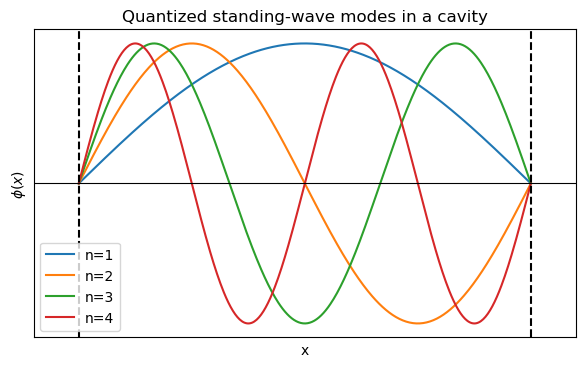

In [6]:
L = 1
x = np.linspace(0, 1, 400)

plt.figure(figsize=(7,4))
for n in [1, 2, 3, 4]:
    # Which of the following correctly represents the allowed standing-wave modes?
    
    # (A) phi = np.sin(2*np.pi*n*x/L)   
    # (B) phi = np.cos(n*np.pi*x/L)       
    # (C) phi = np.sin(n*np.pi*x/L)       
    # (D) phi = np.sin(n*x/L)             
    
    phi = np.sin(n*np.pi*x/L)  # <-- Uncomment the correct line (C)
    plt.plot(x, phi, label=f"n={n}")

plt.axhline(0, color='black', lw=0.8)
plt.title("Quantized standing-wave modes in a cavity")
plt.xlabel("x")
plt.ylabel(r"$\phi (x)$")
plt.legend()
plt.grid(True, alpha=0.3)
plt.xticks([])
plt.yticks([])
plt.xlim(-0.1, 1.1)
plt.axvline(x=0, color='black', linestyle='--')
plt.axvline(x=1, color='black', linestyle='--')
plt.show()

Light (or any wave) trapped between two mirrors forms standing waves. In fact, since $\phi (0) = \phi (L)$, we can imagine “wrapping” the cavity into a closed loop such as a circle. This is the same as waving a flat piece of rope and the bringing the ends together. Use the provided function to see our time dependent waves on a ring.

In [7]:
ring_wave_animation(R=1.0, a=0.18, m=4, c=1.0, Nframes=160, Nt=360)

### QUESTION
Write an expression how the radius of the ring determines the allowable wavelengths.

## PART 2 - STANDING WAVES ON A SPHERE
We have seen how quantization might necessarily arise from the nature of waves, but it may not be completely intutive how this relates to chemistry yet.  
This may become more clear if we consider what wave quantization looks like on a spherical surface.

Before we can visualize the spherical harmonic $Y_\ell^m(\theta, \phi)$, our plotting software requires us to plot in Cartesian coordinates, but electrons around a nucleus give spherical shapes. 

Think back to multivariable calculus, we can map the spherical variables $(r, \theta, \phi)$ (where $r$ is radius, $\theta$ is the polar angle, and $\phi$ is the azimuthal angle) to Cartesian coordinates $(x, y, z)$ using trigonometric relationships.

### QUESTION 
Using what you remember from calculus, how can we express $X$, $Y$, and $Z$ in terms of $R$, $\Theta$, and $\Phi$?  
Define them in the code cell below. 


In [10]:
from scipy.special import sph_harm
import mpl_toolkits.mplot3d.axes3d as axes3d
import matplotlib.colors as mcolors

def plot_spherical_harmonic(l,m):
    '''
    adapted from code at https://github.com/DalInar/schrodingers-snake
    '''
    thetas = np.linspace(0, np.pi, 20)
    phis = np.linspace(0, 2*np.pi, 20)
    
    (Theta,Phi)=np.meshgrid(thetas,phis) 
    s_harm=sph_harm(m, l, Phi, Theta)
       
    R = abs(s_harm.real) 
    # YOUR CODE GOES HERE
    # X = ?
    # Y = ?
    # Z = ?

    vmin = -1
    vmax = 1
    cmap = plt.get_cmap('jet')
    norm = mcolors.Normalize(vmin=Z.min(), vmax=Z.max())
    
    fig = plt.figure(figsize=(8,8))
    ax = fig.add_subplot(1,1,1, projection='3d')
    ax.plot_surface(X, Y, Z, rstride=1, cstride=1, cmap=plt.get_cmap('jet'),facecolors=cmap(norm(R)),
        linewidth=0, antialiased=False, alpha=0.4)

    plt.title(r'Real Part of Spherical Harmonics, $Y_l^m(\theta,\phi)$'+r', $l=$'+str(l)+r', $m=$'+str(m))
    plt.xlabel(r'$x$')
    plt.ylabel(r'$y$')
    plt.ylabel(r'$z$')
    
    plt.show()

### CODE
* Using the provided function, explore different combinations of integer inputs. These inputs correspond to   

In [11]:
plot_spherical_harmonic(0,0)
#try this 5 more times, at least!
#copy paste the function above, with different integer values for l and m

/tmp/ipykernel_1821/2556826331.py:13: DeprecationWarning: `scipy.special.sph_harm` is deprecated as of SciPy 1.15.0 and will be removed in SciPy 1.17.0. Please use `scipy.special.sph_harm_y` instead.
  s_harm=sph_harm(m, l, Phi, Theta)


NameError: name 'Z' is not defined

### SHORT RESPONSE QUESTIONS
1. Where do you recognize these shapes from?  
2. These are not quite what you recognize- These only have wave components depending on $\theta$ and $\phi$. What is the missing wave component?
### ANSWER

<br/><br/>
<br/><br/>
<!--  -->

# REFLECTION

### SHORT RESPONSE QUESTIONS
1. Explain the importance of approximate math and iterative algorithms in the context of computational science.
2. Explain the concept of emergent behavior and provide an example besides those presented here.
3. Explain the connection between quantum mechanics and classical wave mechanics.
### ANSWERS